In [61]:
using Turing
using QuadGK
using StatsPlots
using DelimitedFiles
using StatsBase

In [3]:
BAOm = [1512.39, 81.2087, 1975.22, 90.9029, 2306.68, 98.9647];

In [4]:
BAOcov = [624.707 23.729 325.332 8.34963 157.386 3.57778; 23.729 5.60873 11.6429 2.33996 6.39263 0.968056; 325.332 11.6429 905.777 29.3392 515.271 14.1013; 8.34963 2.33996 29.3392 5.42327 16.1422 2.85334; 157.386 6.39263 515.271 16.1422 1375.12 40.4327; 3.57778 0.968056 14.1013 2.85334 40.4327 6.25936];

In [34]:
@model function BAOmod(BAOmeas)
    Omegam ~ Uniform(0.2, 0.4)
    w ~ Uniform(-1.5, -0.5)
    z = 0.5
    DVmean = quadgk(x ->  3000/0.7/sqrt(Omegam*(1+x)^3 + (1.0 - Omegam)*(1+x)^(3*(w + 1.0))), 0, z)[1]
    Hmean = 70*sqrt(Omegam*(1+z)^3 + (1.0 - Omegam)*(1+z)^(3*(w + 1.0)))
    BAOmeas ~ MvNormal(BAOcov[3:4,3:4]) + [DVmean, Hmean]
end

BAOmod (generic function with 2 methods)

In [157]:
chain = sample(BAOmod(BAOm[3:4]), HMC(0.05, 10), 10000);

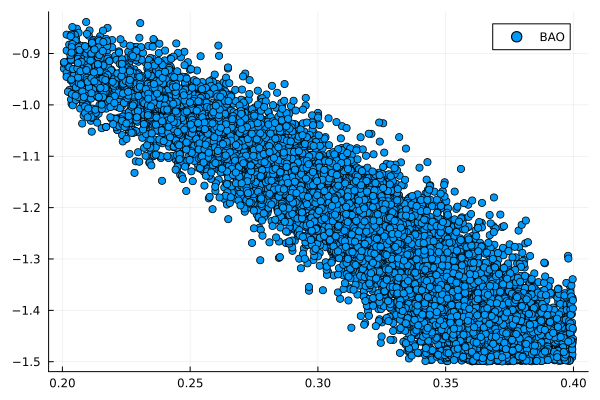

In [158]:
p = scatter(chain[:Omegam], chain[:w], label="BAO")

In [53]:
Ocpv = 0.1240/0.6597^2
Ocp = readdlm("kb_monopole/c102_k_b.txt")
Ocpk = mean(Ocp, dims=2)[1]
Ocmv = 0.1161/0.6736^2
Ocm = readdlm("kb_monopole/c103_k_b.txt")
Ocmk = mean(Ocm, dims=2)[1]
wpv = -0.9
wp = readdlm("kb_monopole/c108_k_b.txt")
wpk = mean(wp, dims=2)[1]
wmv = -1.1
wm = readdlm("kb_monopole/c109_k_b.txt")
wmk = mean(wm, dims=2)[1]

Occv = (Ocpv + Ocmv)/2
wcv = (wpv + wmv)/2
dOc = (Ocpk - Ocmk)/(Ocpv - Ocmv)
dw = (wpk - wmk)/(wpv - wmv)

-0.017017620993190433

In [117]:
kbossm

-0.0008063663653755829

In [92]:
k = Vector()
w = Vector()
for file in readdir("chains_boss")
    if file[1:5] == "bossN" && file[end-2:end] == "txt"
        kb = readdlm(string("chains_boss/", file))
        append!(k, kb[:,3])
        append!(w, kb[:,1])
    end
end


In [95]:
kbossm = sum(k.*w)./sum(w)
kbosss = sqrt.(sum((k .- kbossm).^2 .*w)./sum(w))

0.001275290027135025

In [159]:
@model function kmod(kmeas)
    Omegam ~ Uniform(0.2, 0.4)
    w ~ Uniform(-1.5, -0.5)
    kmeas ~ Normal((Omegam - Occv)*dOc + (w - wcv)*dw, kbosss)
end

kmod (generic function with 2 methods)

In [160]:
chain = sample(kmod(kbossm), HMC(0.05, 10), 10000);

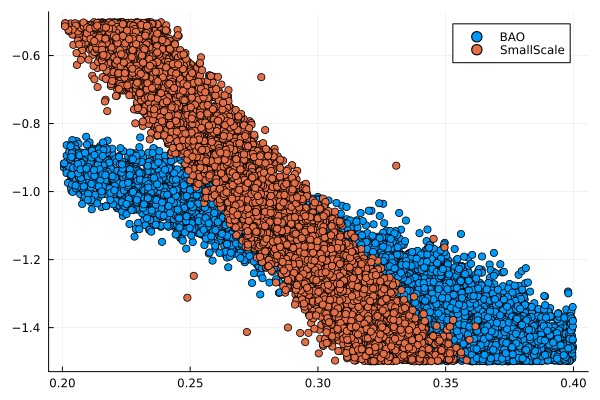

In [161]:
p = scatter!(chain[:Omegam], chain[:w], label="SmallScale")

In [163]:
@model function combined_mod(kmeas, BAOmeas)
    Omegam ~ Uniform(0.2, 0.4)
    w ~ Uniform(-1.5, -0.5)
    kmeas ~ Normal((Omegam - Occv)*dOc + (w - wcv)*dw, kbosss)
    z = 0.5
    DVmean = quadgk(x ->  3000/0.7/sqrt(Omegam*(1+x)^3 + (1.0 - Omegam)*(1+x)^(3*(w + 1.0))), 0, z)[1]
    Hmean = 70*sqrt(Omegam*(1+z)^3 + (1.0 - Omegam)*(1+z)^(3*(w + 1.0)))
    BAOmeas ~ MvNormal(BAOcov[3:4,3:4]) + [DVmean, Hmean]
end

combined_mod (generic function with 2 methods)

In [165]:
chain = sample(combined_mod(kbossm, BAOm[3:4]), HMC(0.05, 10), 10000);

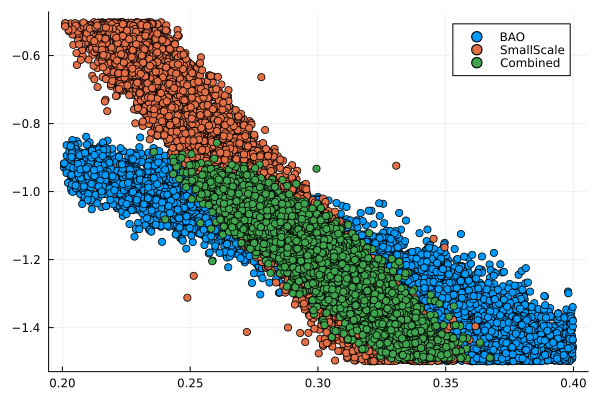

In [166]:
p = scatter!(chain[:Omegam], chain[:w], label="Combined")

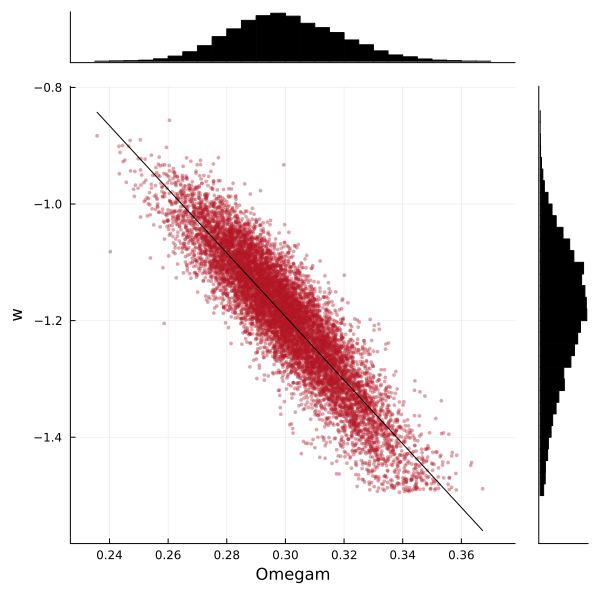

In [169]:
corner(chain)

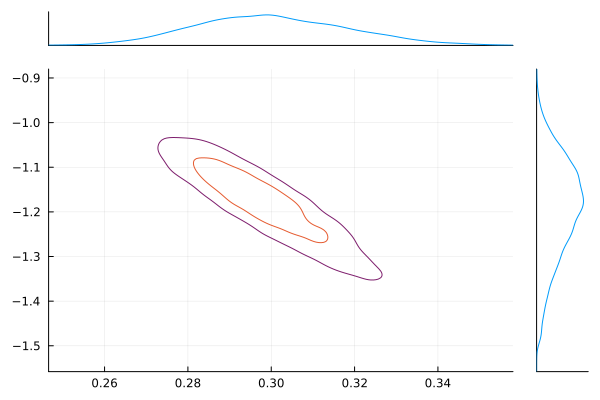

In [172]:
marginalkde(chain[:Omegam], chain[:w], levels=3)